<a href="https://colab.research.google.com/github/SoniaKoplickat13/Sonia13/blob/main/Genre_classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import librosa.display
import os

import numpy as np
import pandas as pd

import librosa
import librosa.display
import soundfile as sf 

import matplotlib.pyplot as plt
import IPython.display as ipd

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix

In [ ]:
from google.colab import drive

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa

drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def download_url(url, save_path):
    with urllib.request.urlopen(url) as dl_file:
        with open(save_path, 'wb') as out_file:
            out_file.write(dl_file.read())

In [ ]:
url  = "https://drive.google.com/drive/folders/1PYw94ZA9p8OxUeHhaBxO_d5yRlbcHwK3?usp=sharing"
save_path = '/content/drive/MyDrive/Data3/Genres.zip'
download_url(url,save_path)

In [ ]:
path = '/content/drive/MyDrive/Data3/Genres'
os.listdir(path)

['S12_hum_4_Frozen_Disney.wav',
 'S12_hum_2_Frozen_Disney.wav',
 'S37_hum_1_Frozen_Disney.wav',
 'S56_hum_2_Frozen_Disney.wav',
 'S38_hum_2_Frozen_Disney.wav',
 'S38_hum_4_Frozen_Disney.wav',
 'S56_whistle_2_Frozen_Disney.wav',
 'S37_whistle_1_Frozen_Disney.wav',
 'S15_hum_2_Frozen_Disney.wav',
 'S18_Hum_2_Frozen_Disney.wav',
 'S18_Whistle_2_Frozen_Disney.wav',
 'S58_hum_4_Frozen_Disney.wav',
 'S15_whistle_2_Frozen_Disney.wav',
 'S17_hum_4_Frozen_Disney.wav',
 'S58_hum_2_Frozen_Disney.wav',
 'S17_hum_2_Frozen_Disney.wav',
 'S80_hum_2_Frozen_Disney.wav',
 'S80_whistle_2_Frozen_Disney.wav',
 'S57_whistle_2_Frozen_Disney.wav',
 'S57_hum_2_Frozen_Disney.wav',
 'S51_hum_2_Frozen_Disney.wav',
 'S26_hum_2_Frozen_Disney.wav',
 'S26_hum_4_Frozen_Disney.wav',
 'S48_Hum_2_Frozen_Disney.wav',
 'S14_hum_2_Frozen_Disney.wav',
 'S51_hum_4_Frozen_Disney.wav',
 'S14_hum_4_Frozen_Disney.wav',
 'S24_hum_2_Frozen_Disney.wav',
 'S24_whistle_2_Frozen_Disney.wav',
 'S48_Whistle_2_Frozen_Disney.wav',
 'S97_hu

In [ ]:

directory_to_extract_to = '/content/drive/MyDrive/Data3/Genres/'
zip_path = '/content/drive/MyDrive/Data3/Genres.zip'

#with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    #zip_ref.extractall(directory_to_extract_to)

sample_path = '/content/drive/MyDrive/Data3/Genres/*.wav'
files = glob.glob(sample_path)
len(files)


840

In [ ]:
for _ in range(5):
  n = np.random.randint(24)
  display(ipd.Audio(files[n]))

In [ ]:
for file in files:
  print(file.split('/')[-1])

S12_hum_4_Frozen_Disney.wav
S12_hum_2_Frozen_Disney.wav
S37_hum_1_Frozen_Disney.wav
S56_hum_2_Frozen_Disney.wav
S38_hum_2_Frozen_Disney.wav
S38_hum_4_Frozen_Disney.wav
S56_whistle_2_Frozen_Disney.wav
S37_whistle_1_Frozen_Disney.wav
S15_hum_2_Frozen_Disney.wav
S18_Hum_2_Frozen_Disney.wav
S18_Whistle_2_Frozen_Disney.wav
S58_hum_4_Frozen_Disney.wav
S15_whistle_2_Frozen_Disney.wav
S17_hum_4_Frozen_Disney.wav
S58_hum_2_Frozen_Disney.wav
S17_hum_2_Frozen_Disney.wav
S80_hum_2_Frozen_Disney.wav
S80_whistle_2_Frozen_Disney.wav
S57_whistle_2_Frozen_Disney.wav
S57_hum_2_Frozen_Disney.wav
S51_hum_2_Frozen_Disney.wav
S26_hum_2_Frozen_Disney.wav
S26_hum_4_Frozen_Disney.wav
S48_Hum_2_Frozen_Disney.wav
S14_hum_2_Frozen_Disney.wav
S51_hum_4_Frozen_Disney.wav
S14_hum_4_Frozen_Disney.wav
S24_hum_2_Frozen_Disney.wav
S24_whistle_2_Frozen_Disney.wav
S48_Whistle_2_Frozen_Disney.wav
S97_hum_4_Frozen_Disney.wav
S104_Hum_4_Frozen_Disney.wav
S63_hum_1_Frozen_Disney.wav
S97_hum_2_Frozen_Disney.wav
S63_hum_3_Froze

In [ ]:
print('The full path to the first audio file is: ', files[0])
print('\n')
print('The name of the first audio file is: ', files[0].split('/')[-1])
print('    The participand ID is: ', files[0].split('/')[-1].split('_')[0])
print('    The type of interpretation is: ', files[0].split('/')[-1].split('_')[1])
print('    The interpretation number is: ', files[0].split('/')[-1].split('_')[2])
print('    The song is: ', files[0].split('/')[-1].split('_')[3])
print('    The genre is:', files[0].split('/')[-1].split('_')[4])


The full path to the first audio file is:  /content/drive/MyDrive/Data3/Genres/S12_hum_4_Frozen_Disney.wav


The name of the first audio file is:  S12_hum_4_Frozen_Disney.wav
    The participand ID is:  S12
    The type of interpretation is:  hum
    The interpretation number is:  4
    The song is:  Frozen
    The genre is: Disney.wav


In [ ]:
#creating a table
AdvancedSolution_table = [] 

for file in files:
  file_name = file.split('/')[-1]
  participant_ID = file.split('/')[-1].split('_')[0]
  interpretation_type = file.split('/')[-1].split('_')[1]
  interpretation_number = file.split('/')[-1].split('_')[0]
  song = file.split('/')[-1].split('_')[3].split('_')[0]
  genre = file.split('/')[-1].split('_')[-1].split('.')[0]


  AdvancedSolution_table.append([file_name,participant_ID,interpretation_type,interpretation_number,song, genre])

AdvancedSolution_table

[['S12_hum_4_Frozen_Disney.wav', 'S12', 'hum', 'S12', 'Frozen', 'Disney'],
 ['S12_hum_2_Frozen_Disney.wav', 'S12', 'hum', 'S12', 'Frozen', 'Disney'],
 ['S37_hum_1_Frozen_Disney.wav', 'S37', 'hum', 'S37', 'Frozen', 'Disney'],
 ['S56_hum_2_Frozen_Disney.wav', 'S56', 'hum', 'S56', 'Frozen', 'Disney'],
 ['S38_hum_2_Frozen_Disney.wav', 'S38', 'hum', 'S38', 'Frozen', 'Disney'],
 ['S38_hum_4_Frozen_Disney.wav', 'S38', 'hum', 'S38', 'Frozen', 'Disney'],
 ['S56_whistle_2_Frozen_Disney.wav',
  'S56',
  'whistle',
  'S56',
  'Frozen',
  'Disney'],
 ['S37_whistle_1_Frozen_Disney.wav',
  'S37',
  'whistle',
  'S37',
  'Frozen',
  'Disney'],
 ['S15_hum_2_Frozen_Disney.wav', 'S15', 'hum', 'S15', 'Frozen', 'Disney'],
 ['S18_Hum_2_Frozen_Disney.wav', 'S18', 'Hum', 'S18', 'Frozen', 'Disney'],
 ['S18_Whistle_2_Frozen_Disney.wav',
  'S18',
  'Whistle',
  'S18',
  'Frozen',
  'Disney'],
 ['S58_hum_4_Frozen_Disney.wav', 'S58', 'hum', 'S58', 'Frozen', 'Disney'],
 ['S15_whistle_2_Frozen_Disney.wav',
  'S15',


In [ ]:
#saving the table into a dataframe
AdvancedSolution_df = pd.DataFrame(AdvancedSolution_table,columns=['file_id','participant','interpretation','number','song','genre']).set_index('file_id') 
AdvancedSolution_df

,participant,interpretation,number,song,genre
file_id,,,,,
S12_hum_4_Frozen_Disney.wav,S12,hum,S12,Frozen,Disney
S12_hum_2_Frozen_Disney.wav,S12,hum,S12,Frozen,Disney
S37_hum_1_Frozen_Disney.wav,S37,hum,S37,Frozen,Disney
S56_hum_2_Frozen_Disney.wav,S56,hum,S56,Frozen,Disney
S38_hum_2_Frozen_Disney.wav,S38,hum,S38,Frozen,Disney
...,...,...,...,...,...
S95_Hum_2_Frozen_Disney.wav,S95,Hum,S95,Frozen,Disney
S95_Hum_2_Hakuna_Disney.wav,S95,Hum,S95,Hakuna,Disney
S95_Whistle_2_Frozen_Disney.wav,S95,Whistle,S95,Frozen,Disney


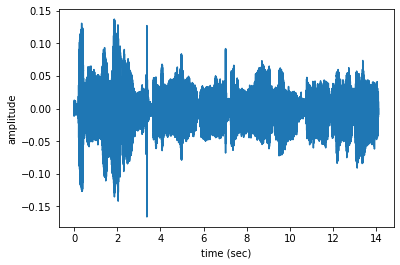

In [ ]:
n=0
fs = None # Sampling frequency. If None, fs would be 22050
x, fs = librosa.load(files[n],sr=fs)
t = np.arange(len(x))/fs
plt.plot(t,x)
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
display(ipd.Audio(files[n]))

In [ ]:
AdvancedSolution_df.loc[files[n].split('/')[-1]]

participant          S12
interpretation       hum
number               S12
song              Frozen
genre             Disney
Name: S12_hum_4_Frozen_Disney.wav, dtype: object

In [ ]:
n=0
x, fs = librosa.load(files[n],sr=fs)
print('This audio signal has', len(x), 'samples')

This audio signal has 621467 samples


In [ ]:
def getPitch(x,fs,winLen=0.02):
  #winLen = 0.02 
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  f0, voiced_flag, voiced_probs = librosa.pyin(y=x, fmin=80, fmax=450, sr=fs,
                                                 frame_length=frame_length,hop_length=hop_length)
  return f0,voiced_flag

In [ ]:
def getEnergy(x,fs,winLen=0.02):
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  energy = np.array([sum(abs(x[i:i+frame_length]**2))for i in range(0, len(x), hop_length)])
  
  return energy

In [ ]:
def getRMS(x,fs,winLen=0.02):
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  rms = librosa.feature.rms(x, frame_length=frame_length, hop_length=hop_length, center=True)
  return rms

In [ ]:

def getXy(files,labels_file, scale_audio=False, onlySingleDigit=False):
  X,y =[],[]
  for file in tqdm(files):
    fileID = file.split('/')[-1]
    file_name = file.split('/')[-1]
    #print(file_name)
    #print(labels_file.loc[fileID]['interpretation'])
    #print(labels_file.loc[fileID]['interpretation']=='hum')
    #yi = list(labels_file.loc[fileID]['interpretation'])[0]=='hum'
    yi = labels_file.loc[fileID]['genre']=='Disney'

    fs = None # if None, fs would be 22050
    x, fs = librosa.load(file,sr=fs)
    if scale_audio: x = x/np.max(np.abs(x))
    f0, voiced_flag = getPitch(x,fs,winLen=0.02)
      
    power = np.sum(x**2)/len(x)
    pitch_mean = np.nanmean(f0) if np.mean(np.isnan(f0))<1 else 0
    pitch_std  = np.nanstd(f0) if np.mean(np.isnan(f0))<1 else 0
    voiced_fr = np.mean(voiced_flag)

    energy_mean = np.mean(getEnergy)
    energy_std = np.std(getEnergy)
    rms_mean = np.mean(getRMS)
    rms_std = np.std(getRMS)
    


    xi = [power,pitch_mean,pitch_std,voiced_fr, energy_mean, energy_std, rms_mean, rms_std]
    X.append(xi)
    y.append(yi)

  return np.array(X),np.array(y)

In [ ]:
X,y = getXy(files, labels_file=AdvancedSolution_df, scale_audio=True, onlySingleDigit=True)

100%|██████████| 840/840 [42:31<00:00,  3.04s/it]


In [ ]:
print('The shape of X is', X.shape) 
print('The shape of y is', y.shape)
print('The labels vector is', y)


The shape of X is (840, 4)
The shape of y is (840,)
The labels vector is [ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  T

In [ ]:
print(' The number of Disney recordings is ', np.count_nonzero(y))
print(' The number of Musical recordings is ', y.size - np.count_nonzero(y))

 The number of Disney recordings is  420
 The number of Musical recordings is  420


## KNN

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 0)

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [ ]:
#Here we will find the best k value for the analysis. 
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score
def find_best_k(X_train, y_train, X_test, y_test, min_k=1, max_k=80):
    best_k = 0
    best_score = 0.0
    for k in range(min_k, max_k+1, 2):
        knn = KNeighborsClassifier(n_neighbors=k)
        knn.fit(X_train, y_train)
        preds = knn.predict(X_test)
        f1 = f1_score(y_test, preds, average='micro')
        if f1 > best_score:
            best_k = k
            best_score = f1
    
    print("Best Value for k: {}".format(best_k))
    print("F1-Score: {}".format(best_score))

In [ ]:
find_best_k(X_train, y_train, X_test, y_test, min_k=1, max_k=90)

Best Value for k: 45
F1-Score: 0.6666666666666666


In [ ]:
knn = KNeighborsClassifier(n_neighbors=53)
knn.fit(X_train, y_train)
preds = knn.predict(X_test)

# RFC 

In [ ]:
from sklearn.metrics import classification_report
def print_metrics(labels, preds):
    print("Precision Score: {}".format(precision_score(labels, preds, average='micro')))
    print("Recall Score: {}".format(recall_score(labels, preds, average='micro')))
    print("Accuracy Score: {}".format(accuracy_score(labels, preds)))
    print("F1 Score: {}".format(f1_score(labels, preds, average='micro')))
    
print_metrics(y_test, preds)

Precision Score: 0.625
Recall Score: 0.625
Accuracy Score: 0.625
F1 Score: 0.625


In [ ]:
print(confusion_matrix(y_test,preds))

[[45 36]
 [27 60]]


In [ ]:
print(classification_report(y_test,preds))

              precision    recall  f1-score   support

       False       0.62      0.56      0.59        81
        True       0.62      0.69      0.66        87

    accuracy                           0.62       168
   macro avg       0.62      0.62      0.62       168
weighted avg       0.62      0.62      0.62       168



In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 0)
forest = RandomForestClassifier(n_estimators=20, max_depth= 5)
forest.fit(X_train, y_train)


RandomForestClassifier(max_depth=5, n_estimators=20)

In [ ]:
forest.score(X_test, y_test)

0.6349206349206349

In [ ]:
def plot_feature_importances(model):
    n_features = X_train.shape[1]
    plt.figure(figsize=(8,8))
    plt.barh(range(n_features), model.feature_importances_, align='center') 
    plt.yticks(np.arange(n_features), X_train.columns.values) 
    plt.xlabel("Feature importance")
    plt.ylabel("Feature")

In [ ]:
pred = forest.predict(X_test)
print(confusion_matrix(y_test, pred))
print(classification_report(y_test, pred))

[[69 54]
 [38 91]]
              precision    recall  f1-score   support

       False       0.64      0.56      0.60       123
        True       0.63      0.71      0.66       129

    accuracy                           0.63       252
   macro avg       0.64      0.63      0.63       252
weighted avg       0.64      0.63      0.63       252



## SVM

In [ ]:
from sklearn import svm
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X,y,test_size=0.2)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((672, 4), (168, 4), (672,), (168,))

In [ ]:
model  = svm.SVC(C=1)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.5788690476190477
Validation  Accuracy 0.5892857142857143
The support vectors are (637, 4)


In [ ]:
mean = X_train.mean(0)
sd =  X_train.std(0)

X_train = (X_train-mean)/sd
X_val  = (X_val-mean)/sd

model  = svm.SVC(C=1,gamma=2)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.78125
Validation  Accuracy 0.625
The support vectors are (592, 4)


## NAIVE BAYES

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

#from sklearn.preprocessing import LabelEncoder
#le = LabelEncoder()
#X[:,0] = le.fit_transform(X[:,0])

# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 0)

# Feature Scaling
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)


from sklearn.naive_bayes import GaussianNB
classifier = GaussianNB()
classifier.fit(X_train, y_train)

# Predicting the Test set results
y_pred = classifier.predict(X_test)

# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix, accuracy_score
ac = accuracy_score(y_test,y_pred)
cm = confusion_matrix(y_test, y_pred)
print(ac)
print(cm)

0.5714285714285714
[[56 25]
 [47 40]]


# K-FOLD CROSS VALIDATION

>KNeighborsClassifier: ideal=0.942, cv=0.942
>SVC: ideal=0.949, cv=0.952
>GaussianNB: ideal=0.855, cv=0.854
>RandomForestClassifier: ideal=0.927, cv=0.927
Correlation: 0.999


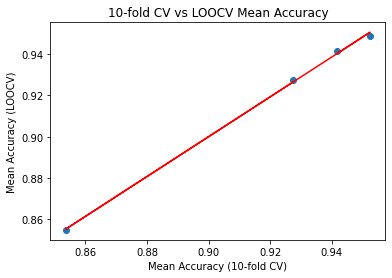

In [ ]:
# correlation between test harness and ideal test condition
from numpy import mean
from numpy import isnan
from numpy import asarray
from numpy import polyfit
from scipy.stats import pearsonr
from matplotlib import pyplot
from sklearn.datasets import make_classification
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import LeaveOneOut


# create the dataset
def get_dataset(n_samples=840):
	X, y = make_classification(n_samples=n_samples, n_features=20, n_informative=15, n_redundant=5, random_state=1)
	return X, y

# get a list of models to evaluate
def get_models():
	models = list()
	models.append(KNeighborsClassifier())
	models.append(SVC())
	models.append(GaussianNB())
	models.append(RandomForestClassifier())
	return models

# evaluate the model using a given test condition
def evaluate_model(cv, model):
	# get the dataset
	X, y = get_dataset()
	# evaluate the model
	scores = cross_val_score(model, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
	# return scores
	return mean(scores)

# define test conditions
ideal_cv = LeaveOneOut()
cv = KFold(n_splits=10, shuffle=True, random_state=1)
# get the list of models to consider
models = get_models()
# collect results
ideal_results, cv_results = list(), list()
# evaluate each model
for model in models:
	# evaluate model using each test condition
	cv_mean = evaluate_model(cv, model)
	ideal_mean = evaluate_model(ideal_cv, model)
	# check for invalid results
	if isnan(cv_mean) or isnan(ideal_mean):
		continue
	# store results
	cv_results.append(cv_mean)
	ideal_results.append(ideal_mean)
	# summarize progress
	print('>%s: ideal=%.3f, cv=%.3f' % (type(model).__name__, ideal_mean, cv_mean))
# calculate the correlation between each test condition
corr, _ = pearsonr(cv_results, ideal_results)
print('Correlation: %.3f' % corr)
# scatter plot of results
pyplot.scatter(cv_results, ideal_results)
# plot the line of best fit
coeff, bias = polyfit(cv_results, ideal_results, 1)
line = coeff * asarray(cv_results) + bias
pyplot.plot(cv_results, line, color='r')
# label the plot
pyplot.title('10-fold CV vs LOOCV Mean Accuracy')
pyplot.xlabel('Mean Accuracy (10-fold CV)')
pyplot.ylabel('Mean Accuracy (LOOCV)')
# show the plot
pyplot.show()